In [46]:
# importing the standard Libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
import sklearn

In [47]:
# Librosa the library for audio files
import librosa
import librosa.display
import IPython.display as ipd
import warnings
warnings.filterwarnings('ignore')

In [48]:
import os
general_path = '/Users/littlebuddha/Desktop/ML project/data_set/data'
print(list(os.listdir(f'{general_path}/genres_original/')))

['pop', '.DS_Store', 'metal', 'disco', 'blues', 'reggae', 'classical', 'rock', 'hiphop', 'country', 'jazz']


# Importing Audio files

In [49]:
# Importing 1 file
y, sr = librosa.load(f'{general_path}/genres_original/metal/metal.00098.wav')

print('y:', y, '\n')
print('y shape:', np.shape(y), '\n')
print('Sample Rate (KHz):', sr, '\n')

y: [-0.06201172 -0.0647583   0.01269531 ...  0.17086792  0.18267822
  0.17208862] 

y shape: (661794,) 

Sample Rate (KHz): 22050 



In [50]:
# Verify length of the audio
print('Check Len of Audio:', 661794/22050)

Check Len of Audio: 30.013333333333332


In [51]:
# Now we trim the silences in the beginning and in the end of the audio samples
audio_file, _ = librosa.effects.trim(y)

# the result is an numpy ndarray
print('Audio File:', audio_file, '\n')
print('Audio File shape:', np.shape(audio_file))

Audio File: [-0.06201172 -0.0647583   0.01269531 ...  0.17086792  0.18267822
  0.17208862] 

Audio File shape: (661794,)


## 2D representation of Sound Waves

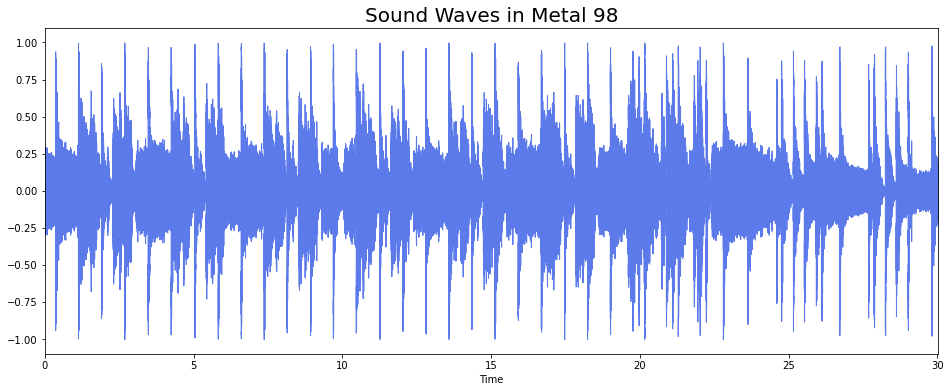

In [83]:
plt.figure(figsize = (16, 6))
librosa.display.waveplot(y = audio_file, sr = sr, color = "#5C7AEA");
plt.title("Sound Waves in Metal 98", fontsize = 20);

## Exploring few Audio Features

### Zero Crossing Rate

the rate at which the signal changes from positive to negative or back.

In [68]:
# Total zero_crossings in our 1 song
zero_crossings = librosa.zero_crossings(audio_file, pad=False)
print(sum(zero_crossings))

76667


### Harmonics and Perceptrual

Harmonics are characteristics that human ears can't distinguish which is represented in red over here and Perceptrual understanding shock wave represents the sound rhythm and emotion represented with blue

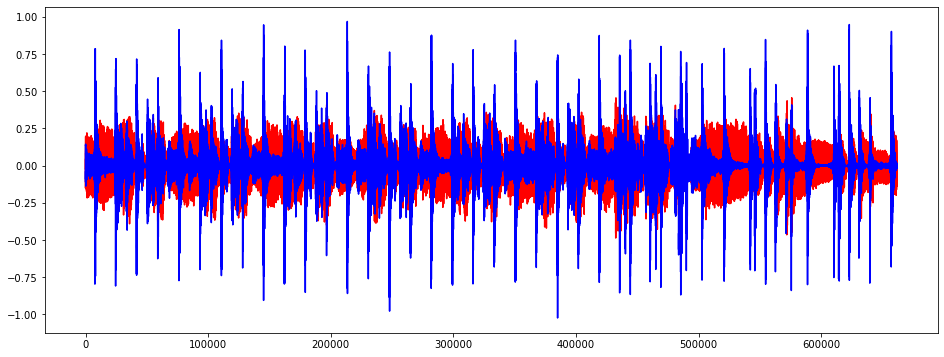

In [72]:
y_harm, y_perc = librosa.effects.hpss(audio_file)

plt.figure(figsize = (16, 6))
plt.plot(y_harm, color = 'red');
plt.plot(y_perc, color = 'blue');

### Tempo/BMP (beats per minute)


In [73]:
tempo, _ = librosa.beat.beat_track(y, sr = sr)
tempo

151.99908088235293

### Spectral Centroid

is calculated as the weighted mean of the frequencies present in the sound

In [76]:
# Calculate the Spectral Centroids
spectral_centroids = librosa.feature.spectral_centroid(audio_file, sr=sr)[0]

# Shape
print('Centroids:', spectral_centroids, '\n')
print('Shape of Spectral Centroids:', spectral_centroids.shape, '\n')

# Computing the time variable
frames = range(len(spectral_centroids))

# Converts frame counts to time (seconds)
t = librosa.frames_to_time(frames)

print('frames:', frames, '\n')
print('t:', t)

# normalising the Sound Data
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)

Centroids: [2510.93136798 2697.3180504  2706.55279729 ... 2477.86040026 2087.25288581
 1687.18876639] 

Shape of Spectral Centroids: (1293,) 

frames: range(0, 1293) 

t: [0.00000000e+00 2.32199546e-02 4.64399093e-02 ... 2.99537415e+01
 2.99769615e+01 3.00001814e+01]


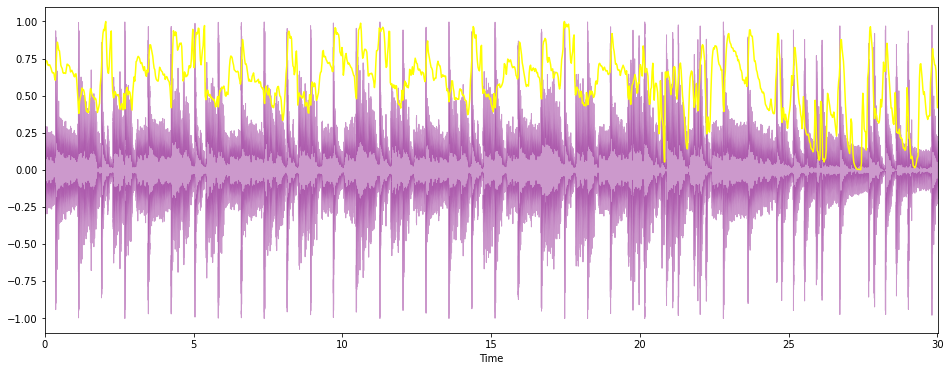

In [82]:
#Plotting the Spectral Centroid along the waveform
plt.figure(figsize = (16, 6))
librosa.display.waveplot(audio_file, sr=sr, alpha=0.4, color = 'purple');
plt.plot(t, normalize(spectral_centroids), color='yellow');

Now that we have explored few of the audio features, lets build the recommendation system

# Recommender system

In [53]:
# Libraries
import IPython.display as ipd
from sklearn.metrics.pairwise import cosine_similarity
from sklearn import preprocessing

# Read data
data = pd.read_csv(f'{general_path}/features_30_sec.csv', index_col='filename')

# Extract labels
labels = data[['label']]

# Drop labels from original dataframe
data = data.drop(columns=['length','label'])
data.head()

# Scale the data
data_scaled=preprocessing.scale(data)
print('Scaled data type:', type(data_scaled))

Scaled data type: <class 'numpy.ndarray'>


In [54]:
# Cosine similarity
similarity = cosine_similarity(data_scaled)
print("Similarity shape:", similarity.shape)

# Convert into a dataframe and then set the row index and column names as labels
sim_df_labels = pd.DataFrame(similarity)
sim_df_names = sim_df_labels.set_index(labels.index)
sim_df_names.columns = labels.index

sim_df_names.head()

Similarity shape: (1000, 1000)


filename,blues.00000.wav,blues.00001.wav,blues.00002.wav,blues.00003.wav,blues.00004.wav,blues.00005.wav,blues.00006.wav,blues.00007.wav,blues.00008.wav,blues.00009.wav,...,rock.00090.wav,rock.00091.wav,rock.00092.wav,rock.00093.wav,rock.00094.wav,rock.00095.wav,rock.00096.wav,rock.00097.wav,rock.00098.wav,rock.00099.wav
filename,,,,,,,,,,,,,,,,,,,,,
blues.00000.wav,1.000000,0.049231,0.589618,0.284862,0.025561,-0.346688,-0.219483,-0.167626,0.641877,-0.097889,...,-0.082829,0.546169,0.578558,0.662590,0.571629,0.610942,0.640835,0.496294,0.284958,0.304098
blues.00001.wav,0.049231,1.000000,-0.096834,0.520903,0.080749,0.307856,0.318286,0.415258,0.120649,0.404168,...,-0.098111,-0.325126,-0.370792,-0.191698,-0.330834,-0.077301,-0.222119,-0.302573,0.499562,0.311723
blues.00002.wav,0.589618,-0.096834,1.000000,0.210411,0.400266,-0.082019,-0.028061,0.104446,0.468113,-0.132532,...,-0.032408,0.561074,0.590779,0.583293,0.514537,0.495707,0.566837,0.589983,0.216378,0.321069
blues.00003.wav,0.284862,0.520903,0.210411,1.000000,0.126437,0.134796,0.300746,0.324566,0.352758,0.295184,...,-0.320107,-0.206516,-0.151132,0.041986,-0.172515,-0.000287,0.020515,-0.107821,0.502279,0.183210
blues.00004.wav,0.025561,0.080749,0.400266,0.126437,1.000000,0.556066,0.482195,0.623455,0.029703,0.471657,...,0.087605,0.017366,0.138035,0.104684,-0.034594,0.063454,0.063546,0.172944,0.153192,0.061785


### Decalring the function

In [55]:
def find_similar_songs(name):
    # Find songs most similar to another song
    series = sim_df_names[name].sort_values(ascending = False)
    
    # Remove cosine similarity == 1 (songs will always have the best match with themselves)
    series = series.drop(name)
    
    # Display the 10 top matches to the given sample data
    print("\n\nSimilar songs to ", name,"\n")
    print(series.head(10))

### Using a Metal genre song to get similar recommendations 

In [56]:
find_similar_songs('metal.00098.wav') 

ipd.Audio(f'{general_path}/genres_original/metal/metal.00098.wav')



Similar songs to  metal.00098.wav 

filename
metal.00099.wav    0.776756
metal.00097.wav    0.755077
metal.00096.wav    0.707320
metal.00095.wav    0.689835
metal.00052.wav    0.683271
metal.00036.wav    0.658800
metal.00012.wav    0.657746
metal.00013.wav    0.655300
disco.00060.wav    0.653718
metal.00080.wav    0.651780
Name: metal.00098.wav, dtype: float64


### Here are 5 of the 10 recommended songs

In [57]:
ipd.Audio(f'{general_path}/genres_original/metal/metal.00099.wav')

In [58]:
ipd.Audio(f'{general_path}/genres_original/metal/metal.00097.wav')

In [59]:
ipd.Audio(f'{general_path}/genres_original/metal/metal.00096.wav')

In [60]:
ipd.Audio(f'{general_path}/genres_original/metal/metal.00095.wav')

In [61]:
ipd.Audio(f'{general_path}/genres_original/metal/metal.00052.wav')

### Using a Rock song to get recommendation

In [62]:
find_similar_songs('rock.00088.wav') 

ipd.Audio(f'{general_path}/genres_original/rock/rock.00088.wav')



Similar songs to  rock.00088.wav 

filename
rock.00082.wav     0.758907
disco.00067.wav    0.732421
blues.00065.wav    0.705699
disco.00048.wav    0.703885
rock.00080.wav     0.697267
rock.00084.wav     0.696258
disco.00052.wav    0.696065
blues.00063.wav    0.686078
metal.00043.wav    0.685958
metal.00064.wav    0.685958
Name: rock.00088.wav, dtype: float64


### Here are 5 of the 10 recommended songs

In [63]:
ipd.Audio(f'{general_path}/genres_original/rock/rock.00082.wav')

In [64]:
ipd.Audio(f'{general_path}/genres_original/disco/disco.00067.wav')

In [65]:
ipd.Audio(f'{general_path}/genres_original/blues/blues.00065.wav')

In [66]:
ipd.Audio(f'{general_path}/genres_original/rock/rock.00080.wav')

In [67]:
ipd.Audio(f'{general_path}/genres_original/metal/metal.00043.wav')

### NOTE
As we can see in this particular example the recommendation system not only searches for similar songs in the same genre but it also searches for simialr songs in all other generes